In [1]:
from openslide.deepzoom import DeepZoomGenerator
from openslide import ImageSlide
from openslide import OpenSlide
import numpy as np
import matplotlib.pyplot as plt
import pickle
import glob
import cv2

In [2]:
img = OpenSlide("training_data_01.svs")

In [3]:
img.level_dimensions

((123504, 90482), (30876, 22620), (7719, 5655), (3859, 2827))

In [4]:
img.level_count

4

In [5]:
img.level_dimensions

((123504, 90482), (30876, 22620), (7719, 5655), (3859, 2827))

In [6]:
img.level_downsamples

(1.0, 4.000044208664898, 16.00017683465959, 32.00525666276758)

In [7]:
small_img = img.read_region((0, 0), 3, (3859, 2827))

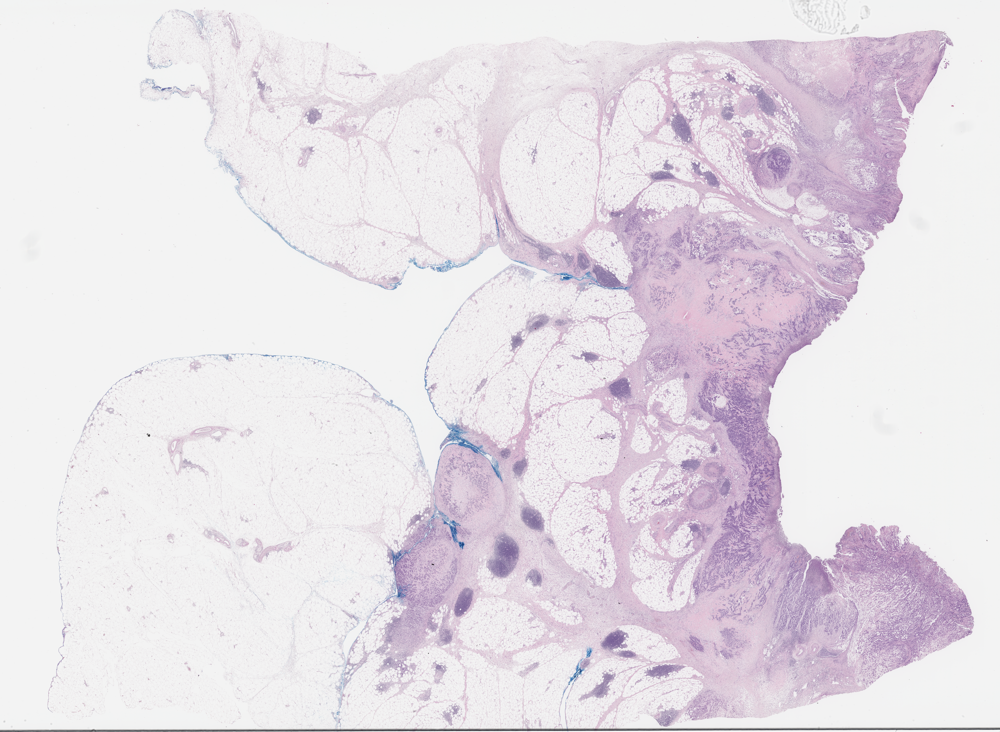

In [8]:
small_img

In [9]:
tmp_img = cv2.cvtColor(np.array(small_img), cv2.COLOR_RGBA2GRAY)

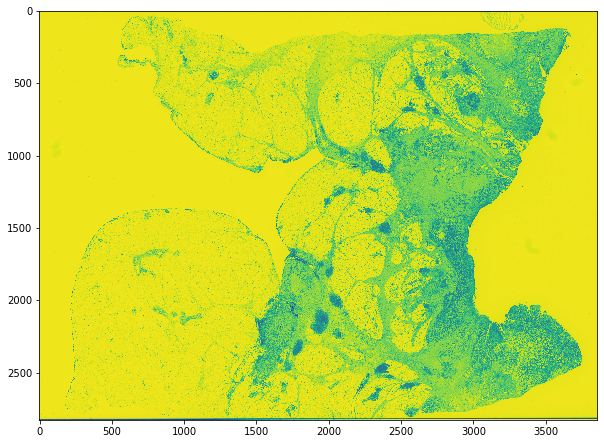

In [10]:
plt.figure(figsize=(10, 10))
plt.imshow(tmp_img)

In [11]:
pkl_list = glob.glob('training_data/*pickle')

In [12]:
pkl_list.sort()

In [13]:
pkl_list[0]

'training_data/training_data_01.pickle'

In [82]:
with open(pkl_list[0], 'rb') as f:
    region_dict = pickle.load(f)

#### cv2 의 x는 행 y는 열
#### plt 의 x는 열 y는 행

In [83]:
for key, value in region_dict.items():
    value = (value / 32).astype('int')
    region_dict[key] = np.array(list(map(lambda x: x[::-1], value)))

### cv2.line -> cv2.findContours -> cv2.drawContours 순으로 mask 얻기

In [71]:
for i in range(len(region_dict['region3']) - 1):
    cv2.line(back, tuple(region_dict['region3'][i][::-1]), tuple(region_dict['region3'][i+1][::-1]), 255, 19)
#     if i == 200:
#         break

plt.figure(figsize=(10, 10))
plt.imshow(back)

contour, _ = cv2.findContours(back, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

contour_img = cv2.drawContours(back, contour, -1, 255, -1)

plt.figure(figsize=(10, 10))
plt.imshow(contour_img)

plt.figure(figsize=(10, 10))
plt.imshow(cv2_img * contour_img)

### cv2.fillPoly 를 통해 한번에 mask 얻을 수 있음

In [86]:
cv2.fillPoly(back, [region_dict['region1']], 255)
cv2.fillPoly(back, [region_dict['region2']], 255)
cv2.fillPoly(back, [region_dict['region3']], 255)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

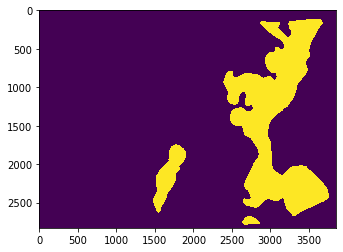

In [87]:
plt.imshow(back)

In [88]:
contour_img = cv2.cvtColor(back, cv2.COLOR_GRAY2RGBA)

In [89]:
contour_img[contour_img != 0] = 1

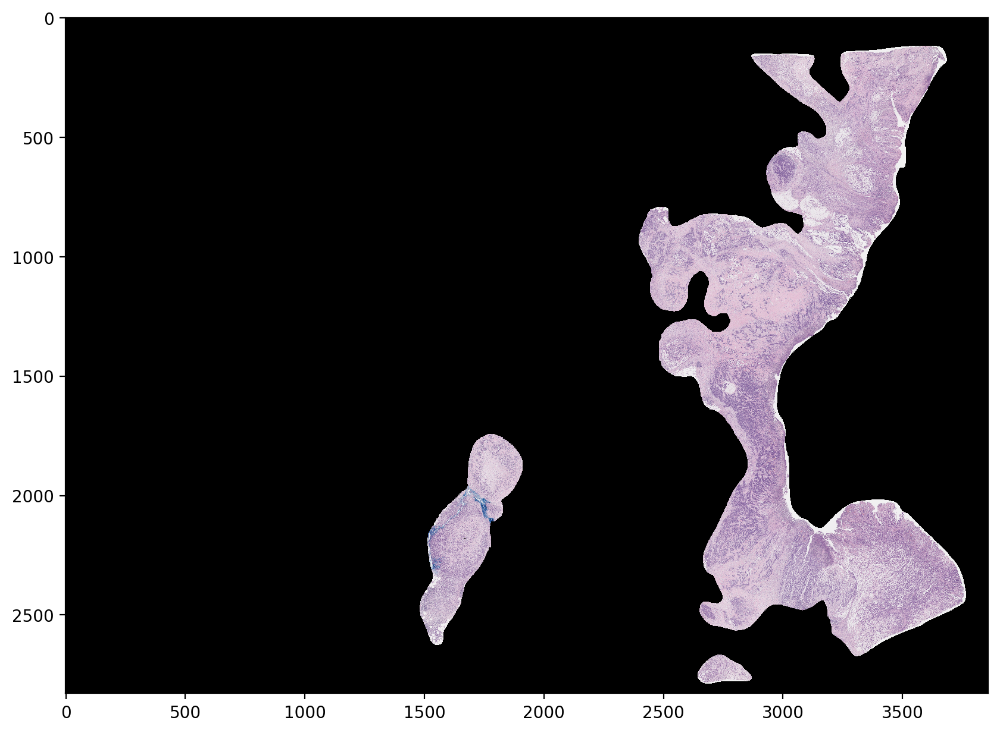

In [92]:
plt.figure(figsize=(10, 10), dpi=200)
plt.imshow(np.array(small_img) * contour_img)
img = np.array(small_img) * contour_img
plt.savefig('img.png', dpi=200)